In [0]:
# 1. Charger la table enregistrée dans le catalogue "default"
df_bronze = spark.table("bases_projet.data_meteo_senegal")  

# 2. Vérifier la structure
df_bronze.printSchema()



root
 |-- date: long (nullable = true)
 |-- T2M: double (nullable = true)
 |-- T2M_MAX: double (nullable = true)
 |-- T2M_MIN: double (nullable = true)
 |-- T2MDEW: double (nullable = true)
 |-- PRECTOTCORR: double (nullable = true)
 |-- WS10M: double (nullable = true)
 |-- WS10M_MAX: double (nullable = true)
 |-- WD10M: double (nullable = true)
 |-- RH2M: double (nullable = true)
 |-- QV2M: double (nullable = true)
 |-- PS: double (nullable = true)
 |-- ALLSKY_SFC_SW_DWN: double (nullable = true)
 |-- CLRSKY_SFC_SW_DWN: double (nullable = true)
 |-- GWETROOT: double (nullable = true)
 |-- EVPTRNS: double (nullable = true)
 |-- ville: string (nullable = true)
 |-- latitude: double (nullable = true)
 |-- longitude: double (nullable = true)
 |-- region: string (nullable = true)



# La variable date est en long : premier problème note

In [0]:
df_bronze.select("region").distinct().show(14, truncate=False)



+-----------+
|region     |
+-----------+
|Dakar      |
|Thiès      |
|Kaolack    |
|Saint-Louis|
|Ziguinchor |
|Diourbel   |
|Fatick     |
|Tambacounda|
|Kolda      |
|Louga      |
|Matam      |
|Kaffrine   |
|Kédougou   |
|Sédhiou    |
+-----------+



In [0]:

# 3. Afficher quelques lignes
df_bronze.show(5)

# 4. Compter le nombre d'observations
n= df_bronze.count()

print(f"Nombre total de lignes lues : {n}")
print("Colonnes détectées :", df_bronze.columns)


+--------+-----+-------+-------+------+-----------+-----+---------+-----+-----+-----+------+-----------------+-----------------+--------+-------+-----+--------+---------+------+
|    date|  T2M|T2M_MAX|T2M_MIN|T2MDEW|PRECTOTCORR|WS10M|WS10M_MAX|WD10M| RH2M| QV2M|    PS|ALLSKY_SFC_SW_DWN|CLRSKY_SFC_SW_DWN|GWETROOT|EVPTRNS|ville|latitude|longitude|region|
+--------+-----+-------+-------+------+-----------+-----+---------+-----+-----+-----+------+-----------------+-----------------+--------+-------+-----+--------+---------+------+
|20000101|21.41|  21.97|  20.84| 18.41|        0.0|  5.6|     7.12|352.4|82.98|13.14|100.93|           5.2382|           5.3321|    0.35| 0.0432|Dakar| 14.6928| -17.4467| Dakar|
|20000102|22.49|  25.07|  20.08| 15.94|        0.0| 4.57|     6.31| 46.3|67.46| 11.3| 100.9|             4.68|           4.7827|    0.35| 0.0298|Dakar| 14.6928| -17.4467| Dakar|
|20000103|22.08|   23.4|  20.53| 15.76|       0.07| 5.32|     7.56| 48.3|67.57|11.11|100.94|           4.6164|

In [0]:
df_bronze.describe().show()


+-------+-------------------+-----------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+-----------------+------------------+-----------------+------------------+------------------+-------------------+----------+------------------+-------------------+----------+
|summary|               date|              T2M|           T2M_MAX|           T2M_MIN|            T2MDEW|       PRECTOTCORR|             WS10M|         WS10M_MAX|             WD10M|              RH2M|             QV2M|                PS|ALLSKY_SFC_SW_DWN| CLRSKY_SFC_SW_DWN|          GWETROOT|            EVPTRNS|     ville|          latitude|          longitude|    region|
+-------+-------------------+-----------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+-----------------+------------------+----------------

In [0]:
from pyspark.sql.functions import col, sum

missing_df = df_bronze.select([
    sum(col(c).isNull().cast("int")).alias(c)
    for c in df_bronze.columns
])

missing_df.show()

+----+---+-------+-------+------+-----------+-----+---------+-----+----+----+---+-----------------+-----------------+--------+-------+-----+--------+---------+------+
|date|T2M|T2M_MAX|T2M_MIN|T2MDEW|PRECTOTCORR|WS10M|WS10M_MAX|WD10M|RH2M|QV2M| PS|ALLSKY_SFC_SW_DWN|CLRSKY_SFC_SW_DWN|GWETROOT|EVPTRNS|ville|latitude|longitude|region|
+----+---+-------+-------+------+-----------+-----+---------+-----+----+----+---+-----------------+-----------------+--------+-------+-----+--------+---------+------+
|   0|  0|      0|      0|     0|          0|    0|        0|    0|   0|   0|  0|                0|                0|       0|      0|    0|       0|        0|     0|
+----+---+-------+-------+------+-----------+-----+---------+-----+----+----+---+-----------------+-----------------+--------+-------+-----+--------+---------+------+



affichage des valeurs manquantes 0
faire un dataframe 

In [0]:
from pyspark.sql.functions import col, to_date

# Calcul des stats de base
stats = df_bronze.describe()

# Transposer le DataFrame pour plus de lisibilité
stats_t = stats.toPandas().set_index('summary').T
stats_t


summary,count,mean,stddev,min,max
date,310488,2.012066798653088E7,72118.34493689395,20000101,20241231
T2M,310488,27.06751062842986,3.332226827108952,16.3,39.29
T2M_MAX,310488,33.555175723377516,5.056062964627627,17.65,47.64
T2M_MIN,310488,21.855502853571576,3.597883145928426,8.43,33.81
T2MDEW,310488,14.735353765684987,8.750827407318562,-14.45,26.51
PRECTOTCORR,310488,1.8750686983077371,6.066077350567377,0.0,608.59
WS10M,310488,4.050063448506909,1.5095393452971217,0.51,12.28
WS10M_MAX,310488,5.789993590734345,1.8825182812150245,0.95,17.0
WD10M,310488,186.48134710520338,126.61343726001641,0.0,360.0
RH2M,310488,55.95352731828629,23.750397158876996,4.03,97.68


Elle contient **310 488** lignes et 20 colonnes. Les colonnes numériques ont été correctement détectées comme double, et les colonnes catégorielles comme string. La seule particularité est que la variable date apparaît en long, ce qui sera corrigé plus tard. Pour les variables de précipitation (PRECTOTCORR), la valeur maximale est de **608,59 mm (assez élevé)** à vérifier. La variable T2MDEW a une température minimale de **-11,51 **degrés celcius ce qui est **impossible**. Pour les incohérences au niveau spatial (coordonnées géographiques), on s'en chargera après.

In [0]:
#transformer le type de la variable "date" en date

df_bronze = df_bronze.withColumn(
    "date",
    to_date(col("date").cast("string"), "yyyyMMdd")
)
df_bronze.select("date").show(5)


+----------+
|      date|
+----------+
|2000-01-01|
|2000-01-02|
|2000-01-03|
|2000-01-04|
|2000-01-05|
+----------+
only showing top 5 rows


In [0]:
df_bronze.printSchema()


root
 |-- date: date (nullable = true)
 |-- T2M: double (nullable = true)
 |-- T2M_MAX: double (nullable = true)
 |-- T2M_MIN: double (nullable = true)
 |-- T2MDEW: double (nullable = true)
 |-- PRECTOTCORR: double (nullable = true)
 |-- WS10M: double (nullable = true)
 |-- WS10M_MAX: double (nullable = true)
 |-- WD10M: double (nullable = true)
 |-- RH2M: double (nullable = true)
 |-- QV2M: double (nullable = true)
 |-- PS: double (nullable = true)
 |-- ALLSKY_SFC_SW_DWN: double (nullable = true)
 |-- CLRSKY_SFC_SW_DWN: double (nullable = true)
 |-- GWETROOT: double (nullable = true)
 |-- EVPTRNS: double (nullable = true)
 |-- ville: string (nullable = true)
 |-- latitude: double (nullable = true)
 |-- longitude: double (nullable = true)
 |-- region: string (nullable = true)



In [0]:
from pyspark.sql.functions import col, count

# Vérifier le nombre d’occurrences par ville-date
dups = (
    df_bronze
        .groupBy("ville", "date")
        .count()
        .filter(col("count") > 1)
)
dups.show(20, truncate=False)
dups.count()


+-----+----+-----+
|ville|date|count|
+-----+----+-----+
+-----+----+-----+



0

In [0]:
# Le nombre de valeur par station et par année
from pyspark.sql.functions import year

df_bronze.groupBy("ville", year("date").alias("annee")).count().orderBy("ville","annee").show(200)


+--------+-----+-----+
|   ville|annee|count|
+--------+-----+-----+
|   Bakel| 2000|  366|
|   Bakel| 2001|  365|
|   Bakel| 2002|  365|
|   Bakel| 2003|  365|
|   Bakel| 2004|  366|
|   Bakel| 2005|  365|
|   Bakel| 2006|  365|
|   Bakel| 2007|  365|
|   Bakel| 2008|  366|
|   Bakel| 2009|  365|
|   Bakel| 2010|  365|
|   Bakel| 2011|  365|
|   Bakel| 2012|  366|
|   Bakel| 2013|  365|
|   Bakel| 2014|  365|
|   Bakel| 2015|  365|
|   Bakel| 2016|  366|
|   Bakel| 2017|  365|
|   Bakel| 2018|  365|
|   Bakel| 2019|  365|
|   Bakel| 2020|  366|
|   Bakel| 2021|  365|
|   Bakel| 2022|  365|
|   Bakel| 2023|  365|
|   Bakel| 2024|  366|
|  Bambey| 2000|  366|
|  Bambey| 2001|  365|
|  Bambey| 2002|  365|
|  Bambey| 2003|  365|
|  Bambey| 2004|  366|
|  Bambey| 2005|  365|
|  Bambey| 2006|  365|
|  Bambey| 2007|  365|
|  Bambey| 2008|  366|
|  Bambey| 2009|  365|
|  Bambey| 2010|  365|
|  Bambey| 2011|  365|
|  Bambey| 2012|  366|
|  Bambey| 2013|  365|
|  Bambey| 2014|  365|
|  Bambey| 

In [0]:
# Pour chaque jour, 
df_bronze.groupBy("date").count().orderBy("count").show(20)


+----------+-----+
|      date|count|
+----------+-----+
|2000-01-20|   34|
|2000-01-14|   34|
|2000-01-17|   34|
|2000-01-19|   34|
|2000-01-11|   34|
|2000-01-13|   34|
|2000-01-10|   34|
|2000-01-16|   34|
|2000-01-18|   34|
|2000-01-08|   34|
|2000-01-02|   34|
|2000-01-06|   34|
|2000-01-05|   34|
|2000-01-12|   34|
|2000-01-01|   34|
|2000-01-07|   34|
|2000-01-04|   34|
|2000-01-15|   34|
|2000-01-03|   34|
|2000-01-09|   34|
+----------+-----+
only showing top 20 rows


In [0]:
from pyspark.sql.functions import year

print("\n TEST 2 — Vérification des jours par année et par ville")

# Comptage des observations
counts = df_bronze.groupBy("ville", year("date").alias("annee")).count()

# On calcule les écarts
errors = counts.filter((col("count") != 365) & (col("count") != 366))

nb_errors = errors.count()

print(f"Nombre d'incohérences détectées : {nb_errors}")

if nb_errors > 0:
    print("\nExemples d'années manquantes ou incomplètes :")
    errors.show(10, truncate=False)
else:
    print("✅ Toutes les villes semblent avoir un nombre normal de jours.")



 TEST 2 — Vérification des jours par année et par ville
Nombre d'incohérences détectées : 0
✅ Toutes les villes semblent avoir un nombre normal de jours.


In [0]:
# Nombre de lignes par station
df_bronze.groupBy("ville").count().orderBy("count", ascending=False).show(35)


+-------------+-----+
|        ville|count|
+-------------+-----+
|       Bambey| 9132|
|       Dagana| 9132|
|     Khombole| 9132|
|    Tivaouane| 9132|
|Joal-Fadiouth| 9132|
|   Ourossogui| 9132|
|       Gossas| 9132|
|        Mbour| 9132|
| Richard-Toll| 9132|
|   Guédiawaye| 9132|
|      Sédhiou| 9132|
|     Linguère| 9132|
|        Kayar| 9132|
|    Vélingara| 9132|
|     Rufisque| 9132|
|      Bignona| 9132|
|  Saint-Louis| 9132|
|        Touba| 9132|
|      Kaolack| 9132|
|        Kolda| 9132|
|  Tambacounda| 9132|
|       Pikine| 9132|
|        Thiès| 9132|
|        Matam| 9132|
|     Diourbel| 9132|
|        Podor| 9132|
|   Ziguinchor| 9132|
|     Kédougou| 9132|
|     Kaffrine| 9132|
|       Mbacké| 9132|
|        Dakar| 9132|
|        Louga| 9132|
|       Fatick| 9132|
|        Bakel| 9132|
+-------------+-----+



In [0]:
from pyspark.sql import functions as F
from pyspark.sql.functions import col

# 1. Bornes "physiques / climatologiques" larges pour chaque variable numérique
bounds = {
    "T2M": (15, 40),
    "T2M_MAX": (25, 48),
    "T2M_MIN": (12, 28),
    "T2MDEW": (5, 28),
    "PRECTOTCORR": (0, 100),
    "WS10M": (0, 40),
    "WS10M_MAX": (0, 60),
    "WD10M": (0, 360),
    "RH2M": (0, 100),
    "QV2M": (0, 30),
    "PS": (95, 105),
    "ALLSKY_SFC_SW_DWN": (0, 35),
    "CLRSKY_SFC_SW_DWN": (0, 35),
    "GWETROOT": (0, 1),
    "EVPTRNS": (0, 10),
    # latitude et longitude volontairement exclues pour traitement carto plus tard
}

# 2. Création de colonnes indicatrices (0/1) "valeur hors bornes"
flag_cols = [
    (
        ((col(var) < lo) | (col(var) > hi))
        .cast("int")
        .alias(var)
    )
    for var, (lo, hi) in bounds.items()
]

anomaly_flags = df_bronze.select(flag_cols)

# 3. Synthèse : nombre de valeurs hors bornes par variable
anomaly_summary = anomaly_flags.agg(
    *[F.sum(c).alias(c) for c in anomaly_flags.columns]
)

from pyspark.sql import functions as F

# 1) Nombre total de lignes (pour le pourcentage)
nb_total = df_bronze.count()

# 2) Transformer anomaly_summary en format long et ajouter le %
anomaly_pretty = (
    anomaly_summary
    .select(
        F.explode(
            F.array(*[
                F.struct(
                    F.lit(c).alias("variable"),
                    F.col(c).alias("nb_anomalies")
                )
                for c in anomaly_summary.columns
            ])
        ).alias("tmp")
    )
    .select("tmp.*")
    .withColumn(
        "pct_anomalies",
        F.round(F.col("nb_anomalies") / nb_total * 100, 3)
    )
    .orderBy(F.desc("nb_anomalies"))
)
# 3) Afficher proprement dans Databricks
display(anomaly_pretty)



variable,nb_anomalies,pct_anomalies
T2MDEW,51695,16.65
T2M_MAX,15109,4.866
T2M_MIN,5892,1.898
PRECTOTCORR,102,0.033
PS,0,0.0
CLRSKY_SFC_SW_DWN,0,0.0
GWETROOT,0,0.0
RH2M,0,0.0
WS10M_MAX,0,0.0
WD10M,0,0.0


L’analyse des anomalies physiques montre que la majorité des variables météorologiques respectent des plages de valeurs cohérentes avec le contexte climatique du Sénégal. Deux variables présentent néanmoins des incohérences notables :

T2MDEW, avec environ 8,3 % de valeurs physiquement impossibles, suggérant des erreurs de mesure ou de traitement.

PRECTOTCORR, avec un nombre très limité d’anomalies (< 0,01 %), correspondant à des épisodes de précipitations extrêmes à vérifier.

In [0]:
from pyspark.sql import functions as F
from pyspark.sql.functions import col, when

df_clean = df_bronze

# Températures 
for v, lo, hi in [
    ("T2M", 0, 55),
    ("T2M_MAX", 0, 60),
    ("T2M_MIN", 0, 45),
    ("T2MDEW", 0, 35),          # Sénégal: point de rosée <0 jugé impossible ici
]:
    if v in df_clean.columns:
        df_clean = df_clean.withColumn(
            v,
            when((col(v) < lo) | (col(v) > hi), F.lit(None)).otherwise(col(v))
        )

# Précipitations (mm/j) : pas de négatif + cap "impossible"
if "PRECTOTCORR" in df_clean.columns:
    df_clean = df_clean.withColumn(
        "PRECTOTCORR",
        when((col("PRECTOTCORR") < 0) | (col("PRECTOTCORR") > 200), F.lit(None)).otherwise(col("PRECTOTCORR"))
    )

# Vent (m/s)
for v, lo, hi in [
    ("WS10M", 0, 60),
    ("WS10M_MAX", 0, 80),
]:
    if v in df_clean.columns:
        df_clean = df_clean.withColumn(
            v,
            when((col(v) < lo) | (col(v) > hi), F.lit(None)).otherwise(col(v))
        )

# Direction du vent (degrés)
if "WD10M" in df_clean.columns:
    df_clean = df_clean.withColumn(
        "WD10M",
        when((col("WD10M") < 0) | (col("WD10M") > 360), F.lit(None)).otherwise(col("WD10M"))
    )

# Humidité relative (%)
if "RH2M" in df_clean.columns:
    df_clean = df_clean.withColumn(
        "RH2M",
        when((col("RH2M") < 0) | (col("RH2M") > 100), F.lit(None)).otherwise(col("RH2M"))
    )

# Humidité spécifique (g/kg) bornes larges
if "QV2M" in df_clean.columns:
    df_clean = df_clean.withColumn(
        "QV2M",
        when((col("QV2M") < 0) | (col("QV2M") > 40), F.lit(None)).otherwise(col("QV2M"))
    )

# Rayonnement (kWh/m²/j) bornes larges
for v in ["ALLSKY_SFC_SW_DWN", "CLRSKY_SFC_SW_DWN"]:
    if v in df_clean.columns:
        df_clean = df_clean.withColumn(
            v,
            when((col(v) < 0) | (col(v) > 35), F.lit(None)).otherwise(col(v))
        )

# Humidité du sol (0-1)
if "GWETROOT" in df_clean.columns:
    df_clean = df_clean.withColumn(
        "GWETROOT",
        when((col("GWETROOT") < 0) | (col("GWETROOT") > 1), F.lit(None)).otherwise(col("GWETROOT"))
    )

# Evapotranspiration (mm/j) bornes larges
if "EVPTRNS" in df_clean.columns:
    df_clean = df_clean.withColumn(
        "EVPTRNS",
        when((col("EVPTRNS") < 0) | (col("EVPTRNS") > 20), F.lit(None)).otherwise(col("EVPTRNS"))
    )




In [0]:
from pyspark.sql import functions as F

# Colonnes numériques à imputer (exclure date, ville, region)
num_cols = [
    "T2M","T2M_MAX","T2M_MIN","T2MDEW","PRECTOTCORR",
    "WS10M","WS10M_MAX","WD10M","RH2M","QV2M",
    "ALLSKY_SFC_SW_DWN","CLRSKY_SFC_SW_DWN","GWETROOT","EVPTRNS"
]

# garder seulement celles qui existent vraiment
num_cols = [c for c in num_cols if c in df_clean.columns]

# Calcul des moyennes (ignore automatiquement les NULL)
means_row = df_clean.agg(*[F.mean(c).alias(c) for c in num_cols]).collect()[0]
means_dict = {c: float(means_row[c]) for c in num_cols}

# Imputation
df_imputed = df_clean.na.fill(means_dict)


Après une phase complète d’ingestion, d’exploration, de nettoyage et d’imputation des données météorologiques, nous disposons d’une base de données propre et cohérente du point de vue statistique. Les aspects géospatiaux ont été traités séparément dans une phase dédiée afin de garantir une analyse spatiale rigoureuse.

In [0]:
### Détection des anomalies spatiaux
from pyspark.sql import functions as F

df_geo = df_bronze.select("ville", "region", "latitude", "longitude")

# Normalisation "diagnostic" (sans modifier tes colonnes originales)
df_geo = (
    df_geo
    .withColumn("ville_norm", F.lower(F.trim(F.col("ville"))))
    .withColumn("region_norm", F.lower(F.trim(F.col("region"))))
)


In [0]:
n_total = df_geo.count()

valid_checks = (
    df_geo
    .withColumn("lat_invalid", F.when((F.col("latitude").isNull()) | (F.col("latitude") < -90) | (F.col("latitude") > 90), 1).otherwise(0))
    .withColumn("lon_invalid", F.when((F.col("longitude").isNull()) | (F.col("longitude") < -180) | (F.col("longitude") > 180), 1).otherwise(0))
)

summary_valid = (
    valid_checks
    .agg(
        F.sum("lat_invalid").alias("nb_lat_invalid_or_null"),
        F.sum("lon_invalid").alias("nb_lon_invalid_or_null"),
        F.sum(F.when((F.col("lat_invalid")==0) & (F.col("lon_invalid")==0), 1).otherwise(0)).alias("nb_coords_globalement_valides")
    )
    .withColumn("total", F.lit(n_total))
    .withColumn("pct_lat_invalid_or_null", F.round(F.col("nb_lat_invalid_or_null")/F.col("total")*100, 3))
    .withColumn("pct_lon_invalid_or_null", F.round(F.col("nb_lon_invalid_or_null")/F.col("total")*100, 3))
    .withColumn("pct_valides", F.round(F.col("nb_coords_globalement_valides")/F.col("total")*100, 3))
)

display(summary_valid)


nb_lat_invalid_or_null,nb_lon_invalid_or_null,nb_coords_globalement_valides,total,pct_lat_invalid_or_null,pct_lon_invalid_or_null,pct_valides
0,0,310488,310488,0.0,0.0,100.0


In [0]:
# Y'a t'il des villes  dont les coordonnées sont hors du Sénégal
bbox = (
    df_geo
    .withColumn(
        "out_senegal_bbox",
        F.when(
            (F.col("latitude").isNull()) | (F.col("longitude").isNull()) |
            (F.col("latitude") < 12) | (F.col("latitude") > 18) |
            (F.col("longitude") < -18) | (F.col("longitude") > -11),
            1
        ).otherwise(0)
    )
)

summary_bbox = (
    bbox
    .agg(
        F.sum("out_senegal_bbox").alias("nb_hors_bbox_senegal"),
        F.sum(F.when(F.col("out_senegal_bbox")==0, 1).otherwise(0)).alias("nb_dans_bbox_senegal")
    )
    .withColumn("total", F.lit(n_total))
    .withColumn("pct_hors_bbox", F.round(F.col("nb_hors_bbox_senegal")/F.col("total")*100, 3))
)

display(summary_bbox)


nb_hors_bbox_senegal,nb_dans_bbox_senegal,total,pct_hors_bbox
9132,301356,310488,2.941


In [0]:
ville_bbox_issues = (
    bbox
    .groupBy("ville_norm")
    .agg(
        F.count("*").alias("nb_obs"),
        F.sum("out_senegal_bbox").alias("nb_hors_bbox")
    )
    .withColumn("pct_hors_bbox", F.round(F.col("nb_hors_bbox")/F.col("nb_obs")*100, 2))
    .filter(F.col("nb_hors_bbox") > 0)
    .orderBy(F.desc("pct_hors_bbox"), F.desc("nb_hors_bbox"))
    .limit(50)
)

display(ville_bbox_issues)


ville_norm,nb_obs,nb_hors_bbox,pct_hors_bbox
bakel,9132,9132,100.0


In [0]:
sent = (
    df_geo
    .withColumn("is_00", F.when((F.col("latitude")==0) & (F.col("longitude")==0), 1).otherwise(0))
    .withColumn("is_lat0", F.when(F.col("latitude")==0, 1).otherwise(0))
    .withColumn("is_lon0", F.when(F.col("longitude")==0, 1).otherwise(0))
)

sent_summary = (
    sent
    .agg(
        F.sum("is_00").alias("nb_coord_0_0"),
        F.sum("is_lat0").alias("nb_lat_0"),
        F.sum("is_lon0").alias("nb_lon_0")
    )
    .withColumn("total", F.lit(n_total))
    .withColumn("pct_0_0", F.round(F.col("nb_coord_0_0")/F.col("total")*100, 3))
    .withColumn("pct_lat_0", F.round(F.col("nb_lat_0")/F.col("total")*100, 3))
    .withColumn("pct_lon_0", F.round(F.col("nb_lon_0")/F.col("total")*100, 3))
)

display(sent_summary)

sent_examples = (
    sent
    .filter((F.col("is_00")==1) | (F.col("is_lat0")==1) | (F.col("is_lon0")==1))
    .select("ville", "region", "latitude", "longitude", "is_00", "is_lat0", "is_lon0")
    .limit(50)
)
display(sent_examples)


nb_coord_0_0,nb_lat_0,nb_lon_0,total,pct_0_0,pct_lat_0,pct_lon_0
0,0,0,310488,0.0,0.0,0.0


ville,region,latitude,longitude,is_00,is_lat0,is_lon0


In [0]:
## Ville dans plusieurs régions?

city_multi_region = (
    df_geo
    .groupBy("ville_norm")
    .agg(
        F.countDistinct("region_norm").alias("nb_regions_distinctes"),
        F.collect_set("region_norm").alias("regions_observees")
    )
    .filter(F.col("nb_regions_distinctes") > 1)
    .orderBy(F.desc("nb_regions_distinctes"))
    .limit(50)
)

display(city_multi_region)


ville_norm,nb_regions_distinctes,regions_observees


In [0]:
# Occurence dans chaque région
region_variants = (
    df_geo
    .groupBy("region_norm")
    .agg(F.count("*").alias("nb_obs"))
    .orderBy(F.desc("nb_obs"))
)

display(region_variants)


region_norm,nb_obs
thiès,54792
dakar,36528
saint-louis,36528
diourbel,36528
fatick,18264
louga,18264
ziguinchor,18264
tambacounda,18264
matam,18264
kolda,18264


In [0]:
ville_variants = (
    df_geo
    .groupBy("ville_norm")
    .agg(
        F.countDistinct("ville").alias("nb_variantes_brutes"),
        F.collect_set("ville").alias("exemples_variantes"),
        F.count("*").alias("nb_obs")
    )
    .filter(F.col("nb_variantes_brutes") > 1)
    .orderBy(F.desc("nb_variantes_brutes"), F.desc("nb_obs"))
    .limit(50)
)
display(ville_variants)


ville_norm,nb_variantes_brutes,exemples_variantes,nb_obs


Les contrôles montrent que les coordonnées géographiques sont globalement valides : aucune latitude ou longitude hors bornes, aucune valeur nulle ou égale à (0,0), et aucune incohérence entre villes et régions après normalisation.
Cependant, environ 3 % des observations se situent en dehors de la bounding box du Sénégal, un problème entièrement concentré sur la ville de Bakel, ce qui indique une erreur systématique de géolocalisation.

In [0]:
from pyspark.sql import functions as F

# Coordonnées officielles de Bakel
BAKEL_LAT = 14.901409
BAKEL_LON = -12.464259

df_clean = (
    df_clean
    .withColumn(
        "latitude",
        F.when(F.lower(F.col("ville")) == "bakel", F.lit(BAKEL_LAT))
         .otherwise(F.col("latitude"))
    )
    .withColumn(
        "longitude",
        F.when(F.lower(F.col("ville")) == "bakel", F.lit(BAKEL_LON))
         .otherwise(F.col("longitude"))
    )
)


In [0]:
from pyspark.sql import functions as F

# =========================
# 1) RENOMMAGE DES VARIABLES (df_clean -> df_clean)
# =========================
rename_dict = {
    "T2M": "temp_mean",
    "T2M_MAX": "temp_max",
    "T2M_MIN": "temp_min",
    "T2MDEW": "dew_point",
    "PRECTOTCORR": "precip_mm",
    "WS10M": "wind_speed",
    "WS10M_MAX": "wind_speed_max",
    "WD10M": "wind_dir",
    "RH2M": "humidity",
    "QV2M": "specific_humidity",
    "PS": "surface_pressure",
    "ALLSKY_SFC_SW_DWN": "solar_rad_allsky",
    "CLRSKY_SFC_SW_DWN": "solar_rad_clearsky",
    "GWETROOT": "soil_moisture",
    "EVPTRNS": "evapotranspiration"
}

for old, new in rename_dict.items():
    if old in df_clean.columns:
        df_clean = df_clean.withColumnRenamed(old, new)

# =========================
# 2) VARIABLES TEMPORELLES (ajout dans df_clean)
# =========================
df_clean = (
    df_clean
    .withColumn("year", F.year("date"))
    .withColumn("month", F.month("date"))
    .withColumn("month_name", F.date_format("date", "MMM"))
    .withColumn("doy", F.dayofyear("date"))
    .withColumn("year_month", F.date_format("date", "yyyy-MM"))
)

# Vérif rapide
display(df_clean.limit(5))


date,temp_mean,temp_max,temp_min,dew_point,precip_mm,wind_speed,wind_speed_max,wind_dir,humidity,specific_humidity,surface_pressure,solar_rad_allsky,solar_rad_clearsky,soil_moisture,evapotranspiration,ville,latitude,longitude,region,year,month,month_name,doy,year_month
2000-01-01,21.41,21.97,20.84,18.41,0.0,5.6,7.12,352.4,82.98,13.14,100.93,5.2382,5.3321,0.35,0.0432,Dakar,14.6928,-17.4467,Dakar,2000,1,Jan,1,2000-01
2000-01-02,22.49,25.07,20.08,15.94,0.0,4.57,6.31,46.3,67.46,11.3,100.9,4.68,4.7827,0.35,0.0298,Dakar,14.6928,-17.4467,Dakar,2000,1,Jan,2,2000-01
2000-01-03,22.08,23.4,20.53,15.76,0.07,5.32,7.56,48.3,67.57,11.11,100.94,4.6164,4.848,0.35,0.0514,Dakar,14.6928,-17.4467,Dakar,2000,1,Jan,3,2000-01
2000-01-04,22.82,25.21,21.04,16.48,4.94,5.05,7.39,66.5,67.45,11.67,100.97,2.3136,4.9493,0.34,0.0386,Dakar,14.6928,-17.4467,Dakar,2000,1,Jan,4,2000-01
2000-01-05,22.1,23.7,20.84,17.69,0.59,4.48,6.56,58.6,76.06,12.55,101.07,4.1503,5.0045,0.35,0.0422,Dakar,14.6928,-17.4467,Dakar,2000,1,Jan,5,2000-01


In [0]:
from pyspark.sql import functions as F

# 1) Agrégation nationale par jour
ts_nat = (
    df_clean
    .groupBy("date")
    .agg(F.avg("temp_mean").alias("temp_mean_nat"))
    .orderBy("date")
)

display(ts_nat)


date,temp_mean_nat
2000-01-01,22.91852941176471
2000-01-02,22.900588235294123
2000-01-03,22.907352941176473
2000-01-04,23.13176470588235
2000-01-05,22.91617647058823
2000-01-06,22.795882352941174
2000-01-07,22.452058823529413
2000-01-08,22.317352941176473
2000-01-09,21.382647058823522
2000-01-10,22.26764705882353


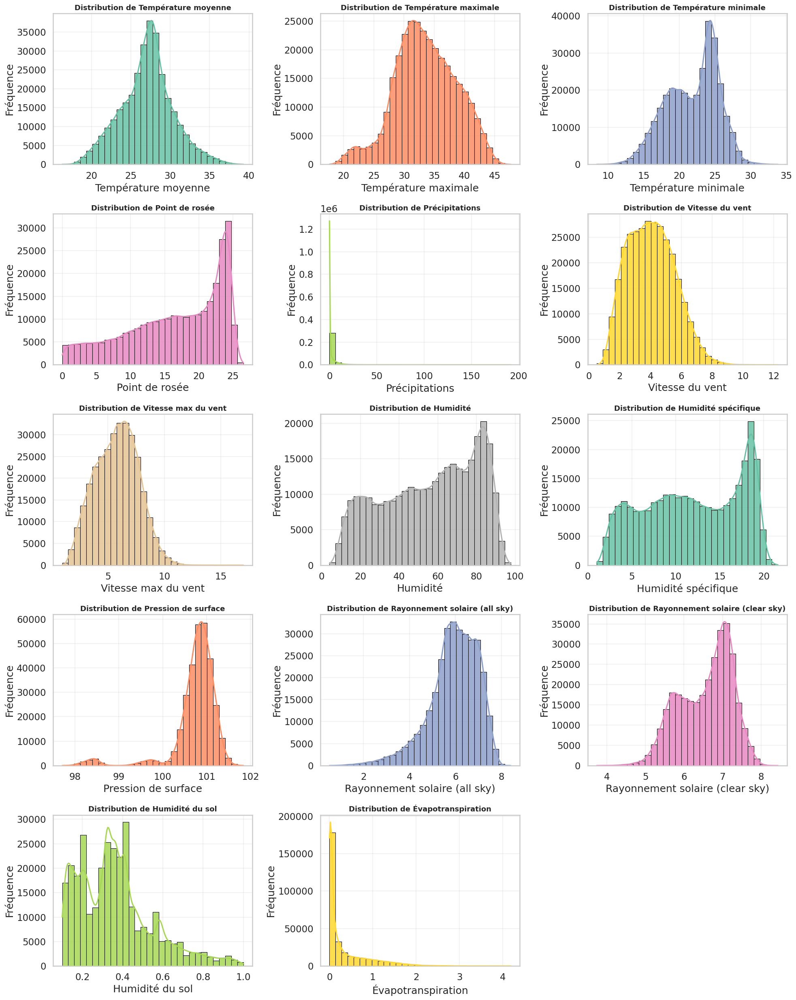

In [0]:
import matplotlib.pyplot as plt
import seaborn as sns
pdf = df_clean.toPandas()

numeric_vars = {
    "temp_mean": "Température moyenne",
    "temp_max": "Température maximale",
    "temp_min": "Température minimale",
    "dew_point": "Point de rosée",
    "precip_mm": "Précipitations",
    "wind_speed": "Vitesse du vent",
    "wind_speed_max": "Vitesse max du vent",
    "humidity": "Humidité",
    "specific_humidity": "Humidité spécifique",
    "surface_pressure": "Pression de surface",
    "solar_rad_allsky": "Rayonnement solaire (all sky)",
    "solar_rad_clearsky": "Rayonnement solaire (clear sky)",
    "soil_moisture": "Humidité du sol",
    "evapotranspiration": "Évapotranspiration"
}

sns.set_theme(style="whitegrid", context="talk")

n_cols = 3
n_rows = (len(numeric_vars) + n_cols - 1) // n_cols

plt.figure(figsize=(20, 5 * n_rows))

palette = sns.color_palette("Set2", n_colors=len(numeric_vars))

for i, ((var, label), color) in enumerate(zip(numeric_vars.items(), palette), start=1):

    if var not in pdf.columns:
        continue

    plt.subplot(n_rows, n_cols, i)

    sns.histplot(
        pdf[var].dropna(),
        bins=30,
        kde=True,
        color=color,
        edgecolor="black",
        linewidth=0.8,
        alpha=0.85
    )

    plt.title(f"Distribution de {label}", fontsize=13, weight="bold")
    plt.xlabel(label)
    plt.ylabel("Fréquence")
    plt.grid(alpha=0.25)
plt.tight_layout()
plt.show()

In [0]:
from pyspark.sql import functions as F

# ✅ 1) Agrégation mensuelle (moyenne nationale par mois)
ts_nat_m = (
    ts_nat
    .withColumn("year_month", F.date_format("date", "yyyy-MM"))
    .groupBy("year_month")
    .agg(F.avg("temp_mean_nat").alias("temp_mean_nat_m"))
    .orderBy("year_month")
)
# ✅ 2)  moyenne mobile 12 mois pour lisser la courbe
ts_nat_m = (
    ts_nat_m
    .withColumn("temp_mean_nat_m_ma12",
                F.avg("temp_mean_nat_m").over(
                    __import__("pyspark").sql.Window.orderBy("year_month").rowsBetween(-11, 0)
                )
    )
)

# ✅ 3) Affichage tableau
display(ts_nat_m)

# ✅ 4) Graphique direct dans Databricks (choisis le chart "Line" dans l'UI)
display(ts_nat_m.select("year_month", "temp_mean_nat_m", "temp_mean_nat_m_ma12"))


/databricks/python/lib/python3.12/site-packages/pyspark/sql/connect/expressions.py:1134: UserWarning: WARN WindowExpression: No Partition Defined for Window operation! Moving all data to a single partition, this can cause serious performance degradation.
  warnings.warn(
/databricks/python/lib/python3.12/site-packages/pyspark/sql/connect/expressions.py:1134: UserWarning: WARN WindowExpression: No Partition Defined for Window operation! Moving all data to a single partition, this can cause serious performance degradation.
  warnings.warn(


year_month,temp_mean_nat_m,temp_mean_nat_m_ma12
2000-01,23.57125237191651,23.57125237191651
2000-02,24.520425963488844,24.045839167702677
2000-03,27.076185958254275,25.05595476455321
2000-04,28.697058823529403,25.96623077929726
2000-05,28.221356736242885,26.417255970686387
2000-06,29.02321568627451,26.851582589951075
2000-07,28.320294117647062,27.06139852247907
2000-08,28.07357685009488,27.18792081343105
2000-09,28.139117647058832,27.2936093505008
2000-10,27.366963946869078,27.30094481013763


year_month,temp_mean_nat_m,temp_mean_nat_m_ma12
2000-01,23.57125237191651,23.57125237191651
2000-02,24.520425963488844,24.045839167702677
2000-03,27.076185958254275,25.05595476455321
2000-04,28.697058823529403,25.96623077929726
2000-05,28.221356736242885,26.417255970686387
2000-06,29.02321568627451,26.851582589951075
2000-07,28.320294117647062,27.06139852247907
2000-08,28.07357685009488,27.18792081343105
2000-09,28.139117647058832,27.2936093505008
2000-10,27.366963946869078,27.30094481013763


/databricks/python/lib/python3.12/site-packages/pyspark/sql/connect/expressions.py:1134: UserWarning: WARN WindowExpression: No Partition Defined for Window operation! Moving all data to a single partition, this can cause serious performance degradation.
  warnings.warn(


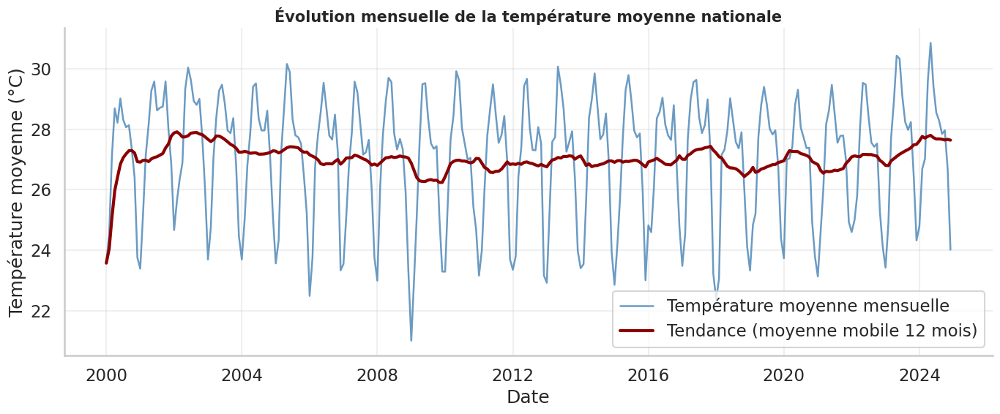

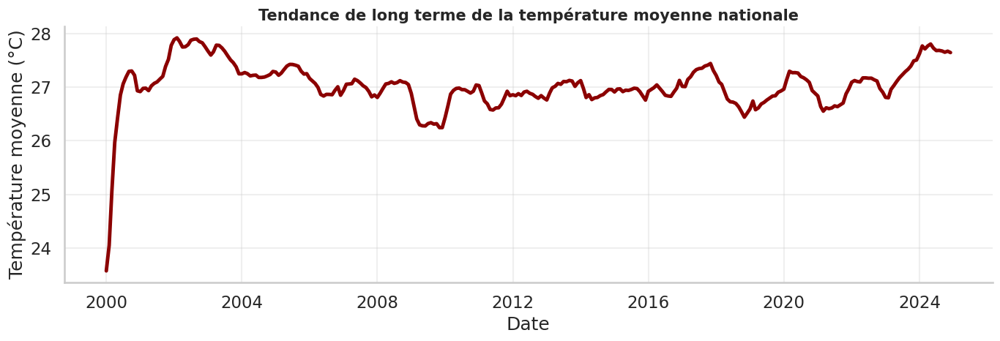

In [0]:
#graphique des tendance de la temperature moyenne
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_theme(
    style="whitegrid",
    context="talk"
)
# ======================================================
# 2. Conversion Spark -> pandas
# ======================================================
pdf_m = ts_nat_m.toPandas()

# Axe temporel propre
pdf_m["year_month"] = pd.to_datetime(pdf_m["year_month"])
pdf_m = pdf_m.sort_values("year_month")

plt.figure(figsize=(14,6))

# Série mensuelle
plt.plot(
    pdf_m["year_month"],
    pdf_m["temp_mean_nat_m"],
    color="steelblue",
    linewidth=1.8,
    alpha=0.8,
    label="Température moyenne mensuelle"
)

# Tendance (MA 12 mois)
plt.plot(
    pdf_m["year_month"],
    pdf_m["temp_mean_nat_m_ma12"],
    color="darkred",
    linewidth=3,
    label="Tendance (moyenne mobile 12 mois)"
)

plt.title(
    "Évolution mensuelle de la température moyenne nationale",
    fontsize=15,
    weight="bold"
)
plt.xlabel("Date")
plt.ylabel("Température moyenne (°C)")
plt.legend()
plt.grid(alpha=0.3)

sns.despine()
plt.tight_layout()
plt.show()


plt.figure(figsize=(14,5))

plt.plot(
    pdf_m["year_month"],
    pdf_m["temp_mean_nat_m_ma12"],
    color="darkred",
    linewidth=3.5
)

plt.title(
    "Tendance de long terme de la température moyenne nationale",
    fontsize=15,
    weight="bold"
)
plt.xlabel("Date")
plt.ylabel("Température moyenne (°C)")
plt.grid(alpha=0.3)

sns.despine()
plt.tight_layout()
plt.show()

In [0]:
# =========================
# DISTRIBUTIONS UNIVARIÉES (df_clean)
# - Histogrammes (approx via buckets)
# - Boxplot (quantiles)
# - % de valeurs null
# =========================
from pyspark.sql import functions as F

# 🔧 0) Liste des variables météo (mets/retire celles que tu veux)
meteo_vars = [
    "temp_mean", "temp_max", "humidity", "dew_point", "precip_mm",
    "wind_speed_max", "wind_dir", "surface_pressure",
    "solar_rad_clearsky", "soil_moisture", "specific_humidity"
]

# 🔧 1) Profil univarié : n, n_null, mean, std, min, p25, median, p75, max
# (percentile_approx est la bonne méthode Spark pour les quantiles)
profile_exprs = []
for c in meteo_vars:
    profile_exprs += [
        F.count(F.col(c)).alias(f"{c}__n_non_null"),
        F.sum(F.col(c).isNull().cast("int")).alias(f"{c}__n_null"),
        F.avg(F.col(c)).alias(f"{c}__mean"),
        F.stddev(F.col(c)).alias(f"{c}__std"),
        F.min(F.col(c)).alias(f"{c}__min"),
        F.expr(f"percentile_approx({c}, 0.25, 10000)").alias(f"{c}__p25"),
        F.expr(f"percentile_approx({c}, 0.50, 10000)").alias(f"{c}__p50"),
        F.expr(f"percentile_approx({c}, 0.75, 10000)").alias(f"{c}__p75"),
        F.max(F.col(c)).alias(f"{c}__max"),
    ]

wide = df_clean.agg(*profile_exprs)

# wide -> long propre (une ligne par variable)
rows = []
for c in meteo_vars:
    rows.append(
        F.struct(
            F.lit(c).alias("variable"),
            F.col(f"{c}__n_non_null").alias("n_non_null"),
            F.col(f"{c}__n_null").alias("n_null"),
            (F.col(f"{c}__n_null") / (F.col(f"{c}__n_non_null") + F.col(f"{c}__n_null"))).alias("pct_null"),
            F.col(f"{c}__mean").alias("mean"),
            F.col(f"{c}__std").alias("std"),
            F.col(f"{c}__min").alias("min"),
            F.col(f"{c}__p25").alias("p25"),
            F.col(f"{c}__p50").alias("median"),
            F.col(f"{c}__p75").alias("p75"),
            F.col(f"{c}__max").alias("max"),
        )
    )

univar_profile = wide.select(F.explode(F.array(*rows)).alias("r")).select("r.*")
display(univar_profile)

# 🔧 2) “Boxplot” prêt pour Databricks (quantiles) : tu peux le tracer en bar/line
# (En pratique, Databricks ne fait pas un vrai boxplot natif, donc on plot les quantiles)
box_ready = univar_profile.select("variable", "min", "p25", "median", "p75", "max")
display(box_ready)

# 🔧 3) Histogrammes approximatifs (buckets) — rapide et scalable
# ⚠️ pour chaque variable : bucketize entre p1 et p99 (pour éviter que 2 valeurs extrêmes cassent tout)
hist_all = None
for c in meteo_vars:
    q = (
        df_clean
        .select(
            F.expr(f"percentile_approx({c}, 0.01, 10000)").alias("p01"),
            F.expr(f"percentile_approx({c}, 0.99, 10000)").alias("p99")
        )
        .collect()[0]
    )
    p01, p99 = q["p01"], q["p99"]

    # si p01/p99 null (colonne vide), on skip
    if p01 is None or p99 is None or p01 == p99:
        continue

    # 30 bins
    nbins = 30
    step = (p99 - p01) / nbins

    hist_c = (
        df_clean
        .where(F.col(c).isNotNull())
        .where((F.col(c) >= F.lit(p01)) & (F.col(c) <= F.lit(p99)))
        .withColumn("bin", F.floor((F.col(c) - F.lit(p01)) / F.lit(step)).cast("int"))
        .where(F.col("bin").between(0, nbins-1))
        .groupBy("bin")
        .agg(F.count("*").alias("count"))
        .withColumn("variable", F.lit(c))
        .withColumn("bin_start", F.lit(p01) + F.col("bin") * F.lit(step))
        .withColumn("bin_end", F.lit(p01) + (F.col("bin")+1) * F.lit(step))
        .select("variable", "bin", "bin_start", "bin_end", "count")
        .orderBy("variable", "bin")
    )

    hist_all = hist_c if hist_all is None else hist_all.unionByName(hist_c)

display(hist_all)

# ✅ Pour voir un histogramme "joli" dans Databricks :
# - filtre variable == "temp_mean"
# - plot : X = bin_start (ou bin), Y = count (bar chart)


variable,n_non_null,n_null,pct_null,mean,std,min,p25,median,p75,max
temp_mean,310488,0,0.0,27.06751062842986,3.332226827108952,16.3,24.99,27.22,28.99,39.29
temp_max,310488,0,0.0,33.555175723377516,5.056062964627627,17.65,30.16,33.34,37.21,47.64
humidity,310488,0,0.0,55.95352731828629,23.750397158876996,4.03,36.41,59.43,77.33,97.68
dew_point,284597,25891,0.08338808585194919,16.4170484931327,6.998063979603202,0.0,11.43,17.81,22.85,26.51
precip_mm,310472,16,5.153178222668831E-5,1.8587186928295352,5.56507164711005,0.0,0.0,0.0,0.98,191.44
wind_speed_max,310488,0,0.0,5.789993590734345,1.8825182812150245,0.95,4.37,5.86,7.14,17.0
wind_dir,310488,0,0.0,186.48134710520338,126.61343726001641,0.0,52.6,228.8,303.5,360.0
surface_pressure,310488,0,0.0,100.75165201231651,0.5308303290830679,97.71,100.64,100.84,101.03,101.84
solar_rad_clearsky,310488,0,0.0,6.56330284004538,0.6792399520306837,3.7414,6.0082,6.7087,7.0992,8.4334
soil_moisture,310488,0,0.0,0.3644743436140768,0.1855355056898789,0.1,0.22,0.34,0.45,1.0


variable,min,p25,median,p75,max
temp_mean,16.3,24.99,27.22,28.99,39.29
temp_max,17.65,30.16,33.34,37.21,47.64
humidity,4.03,36.41,59.43,77.33,97.68
dew_point,0.0,11.43,17.81,22.85,26.51
precip_mm,0.0,0.0,0.0,0.98,191.44
wind_speed_max,0.95,4.37,5.86,7.14,17.0
wind_dir,0.0,52.6,228.8,303.5,360.0
surface_pressure,97.71,100.64,100.84,101.03,101.84
solar_rad_clearsky,3.7414,6.0082,6.7087,7.0992,8.4334
soil_moisture,0.1,0.22,0.34,0.45,1.0


variable,bin,bin_start,bin_end,count
temp_mean,0,19.46,19.99266666666667,2479
temp_mean,1,19.99266666666667,20.525333333333332,3334
temp_mean,2,20.525333333333332,21.058,4181
temp_mean,3,21.058,21.590666666666667,5476
temp_mean,4,21.590666666666667,22.123333333333335,6286
temp_mean,5,22.123333333333335,22.656,7457
temp_mean,6,22.656,23.188666666666666,8396
temp_mean,7,23.188666666666666,23.721333333333334,10001
temp_mean,8,23.721333333333334,24.253999999999998,10647
temp_mean,9,24.253999999999998,24.786666666666665,11671


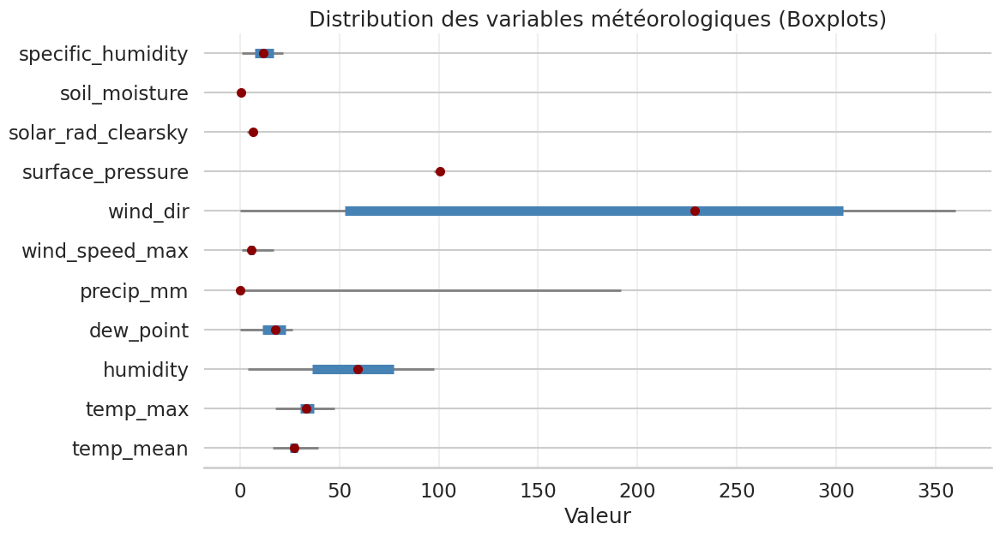

In [0]:
# ======================================================
# GRAPHIQUES UNIVARIÉS (Spark -> Python) — CODE COMPLET
# ======================================================

# ------------------------------
# 0) Imports & style global
# ------------------------------
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_theme(style="whitegrid", context="talk")

# ------------------------------
# 1) Conversions Spark -> pandas
# ------------------------------
box_pdf  = box_ready.toPandas()            # min, p25, median, p75, max
hist_pdf = hist_all.toPandas()             # histogrammes par buckets
null_pdf = univar_profile.select(
    "variable", "pct_null"
).toPandas()                               # % de valeurs nulles

# ======================================================
# 2) BOXPLOTS ÉLÉGANTS (reconstruits depuis les quantiles)
# ======================================================
plt.figure(figsize=(12, 0.6 * len(box_pdf)))

for i, row in box_pdf.iterrows():
    # min -> max
    plt.hlines(y=i, xmin=row["min"], xmax=row["max"],
               color="gray", linewidth=2)
    # Q1 -> Q3
    plt.hlines(y=i, xmin=row["p25"], xmax=row["p75"],
               color="steelblue", linewidth=8)
    # médiane
    plt.plot(row["median"], i, "o", color="darkred", markersize=7)

plt.yticks(range(len(box_pdf)), box_pdf["variable"])
plt.xlabel("Valeur")
plt.title("Distribution des variables météorologiques (Boxplots)")
plt.grid(axis="x", alpha=0.3)
sns.despine(left=True)
plt.tight_layout()
plt.show()



In [0]:
#RAYAN
# ======================================================
# SCATTER MAP INTERACTIVE — TEMPÉRATURE (Plotly)
# ======================================================

import plotly.express as px

# Spark -> pandas (réduction possible si très gros)
map_pdf = (
    df_clean
    .select("latitude", "longitude", "temp_mean")
    .dropna()
    .toPandas()
)

# Carte scatter
fig = px.scatter_mapbox(
    map_pdf,
    lat="latitude",
    lon="longitude",
    color="temp_mean",
    size="temp_mean",
    color_continuous_scale="Viridis",
    zoom=5,
    height=600,
    title="Distribution spatiale de la température moyenne (stations)"
)

fig.update_layout(
    mapbox_style="carto-positron",
    margin={"r":0, "t":50, "l":0, "b":0}
)

# IMPORTANT sur Databricks : NE PAS utiliser fig.show()
fig

In [0]:
pip install geopandas

In [0]:
# RAYAN
# ======================================================
# CHOROPLÈTHE — TEMPÉRATURE MOYENNE PAR RÉGION (SÉNÉGAL)
# ANNÉE : 2002
# ======================================================

import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_theme(style="white", context="talk")

# ------------------------------------------------------
# 1) DONNÉES STATIONS (Spark -> pandas) — ANNÉE 2002
# ------------------------------------------------------
stations = (
    df_clean
    .withColumn("year", df_clean.date.substr(1, 4))
    .filter(df_clean.year == "2002")
    .select("latitude", "longitude", "temp_mean")
    .dropna()
    .toPandas()
)

# Conversion en GeoDataFrame
stations_gdf = gpd.GeoDataFrame(
    stations,
    geometry=gpd.points_from_xy(
        stations["longitude"],
        stations["latitude"]
    ),
    crs="EPSG:4326"
)

# ------------------------------------------------------
# 2) FRONTIÈRES ADMINISTRATIVES DU SÉNÉGAL (RÉGIONS)
# ------------------------------------------------------
regions = gpd.read_file(
    "https://geodata.ucdavis.edu/gadm/gadm4.1/json/gadm41_SEN_1.json"
).to_crs("EPSG:4326")

# ------------------------------------------------------
# 3) AFFECTATION DES STATIONS AUX RÉGIONS
# ------------------------------------------------------
stations_regions = gpd.sjoin(
    stations_gdf,
    regions,
    how="inner",
    predicate="within"
)

# ------------------------------------------------------
# 4) AGRÉGATION : TEMPÉRATURE MOYENNE PAR RÉGION (2002)
# ------------------------------------------------------
temp_region = (
    stations_regions
    .groupby("NAME_1")["temp_mean"]
    .mean()
    .reset_index()
)

# ------------------------------------------------------
# 5) JOINTURE POUR LA CHOROPLÈTHE
# ------------------------------------------------------
regions_map = regions.merge(
    temp_region,
    on="NAME_1",
    how="left"
)

# ------------------------------------------------------
# 6) CARTE CHOROPLÈTHE (SANS STATIONS)
# ------------------------------------------------------
fig, ax = plt.subplots(1, 1, figsize=(8, 10))

regions_map.plot(
    column="temp_mean",
    cmap="inferno",
    linewidth=0.8,
    edgecolor="black",
    legend=True,
    legend_kwds={
        "label": "Température moyenne (°C)",
        "shrink": 0.6
    },
    ax=ax
)

# ------------------------------------------------------
# 7) AFFICHAGE DES NOMS DES RÉGIONS
# ------------------------------------------------------
for idx, row in regions_map.iterrows():
    if row.geometry is not None:
        centroid = row.geometry.centroid
        ax.text(
            centroid.x,
            centroid.y,
            row["NAME_1"],
            horizontalalignment="center",
            fontsize=9,
            color="black"
        )

ax.set_title(
    "Température moyenne par région au Sénégal (2002)",
    fontsize=14,
    weight="bold"
)
ax.set_axis_off()

plt.tight_layout()
plt.show()

---------------------------------------------------------------------------
ModuleNotFoundError                       Traceback (most recent call last)
File <command-6563756598383124>, line 8
      1 # RAYAN
      2 # ======================================================
      3 # CHOROPLÈTHE — TEMPÉRATURE MOYENNE PAR RÉGION (SÉNÉGAL)
      4 # ANNÉE : 2002
      5 # ======================================================
      7 import pandas as pd
----> 8 import geopandas as gpd
      9 import matplotlib.pyplot as plt
     10 import seaborn as sns

ModuleNotFoundError: No module named 'geopandas'

In [0]:
# RAYAN
# RAYAN
# ======================================================
# CHOROPLÈTHES ANNUELLES PAR RÉGION
# REGROUPÉES PAR TRANCHES DE 10 ANS (2000–2024)
# ======================================================

import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
from pyspark.sql import functions as F

sns.set_theme(style="white", context="talk")

# ------------------------------------------------------
# 1) DONNÉES STATIONS AVEC ANNÉE
# ------------------------------------------------------
stations = (
    df_clean
    .withColumn("year", F.year("date"))
    .filter((F.col("year") >= 2000) & (F.col("year") <= 2024))
    .select("latitude", "longitude", "temp_mean", "year")
    .dropna()
    .toPandas()
)

stations_gdf = gpd.GeoDataFrame(
    stations,
    geometry=gpd.points_from_xy(
        stations["longitude"],
        stations["latitude"]
    ),
    crs="EPSG:4326"
)

# ------------------------------------------------------
# 2) RÉGIONS DU SÉNÉGAL
# ------------------------------------------------------
regions = gpd.read_file(
    "https://geodata.ucdavis.edu/gadm/gadm4.1/json/gadm41_SEN_1.json"
).to_crs("EPSG:4326")

# ------------------------------------------------------
# 3) STATIONS → RÉGIONS
# ------------------------------------------------------
stations_regions = gpd.sjoin(
    stations_gdf,
    regions,
    how="inner",
    predicate="within"
)

# ------------------------------------------------------
# 4) TEMPÉRATURE MOYENNE PAR RÉGION ET PAR ANNÉE
# ------------------------------------------------------
temp_region_year = (
    stations_regions
    .groupby(["NAME_1", "year"])["temp_mean"]
    .mean()
    .reset_index()
)

# ------------------------------------------------------
# 5) DÉFINITION DES TRANCHES DE 10 ANS
# ------------------------------------------------------
decades = {
    "2000–2009": list(range(2000, 2010)),
    "2010–2019": list(range(2010, 2020)),
    "2020–2024": list(range(2020, 2025))
}

# ------------------------------------------------------
# 6) CHOROPLÈTHES PAR ANNÉE, REGROUPÉES PAR DÉCENNIE
# ------------------------------------------------------
for dec_label, years in decades.items():

    n_years = len(years)
    n_cols = 5
    n_rows = (n_years + n_cols - 1) // n_cols

    fig, axes = plt.subplots(
        n_rows, n_cols,
        figsize=(4 * n_cols, 4 * n_rows),
        sharex=True,
        sharey=True
    )

    axes = axes.flatten()

    for i, year in enumerate(years):
        ax = axes[i]

        # jointure régions + année
        reg_map = regions.merge(
            temp_region_year[temp_region_year["year"] == year],
            on="NAME_1",
            how="left"
        )

        reg_map.plot(
            column="temp_mean",
            cmap="inferno",
            linewidth=0.4,
            edgecolor="black",
            ax=ax,
            legend=False
        )

        ax.set_title(str(year), fontsize=10)
        ax.set_axis_off()

    # Supprimer les axes vides
    for j in range(i + 1, len(axes)):
        axes[j].axis("off")

    # Titre de la décennie
    fig.suptitle(
        f"Température moyenne par région — {dec_label}",
        fontsize=16,
        weight="bold"
    )

    plt.tight_layout()
    plt.show()

In [0]:
## ======================================================
# CHOROPLÈTHE ÉVOLUTIVE PURE (SÉNÉGAL UNIQUEMENT)
# 2000–2024 — TEMPÉRATURE MOYENNE PAR RÉGION
# ======================================================

import pandas as pd
import geopandas as gpd
import plotly.express as px
from pyspark.sql import functions as F

# ------------------------------------------------------
# 1) TEMPÉRATURE MOYENNE PAR RÉGION ET PAR ANNÉE
# ------------------------------------------------------
stations = (
    df_clean
    .withColumn("year", F.year("date"))
    .filter((F.col("year") >= 2000) & (F.col("year") <= 2024))
    .select("latitude", "longitude", "temp_mean", "year")
    .dropna()
    .toPandas()
)

stations_gdf = gpd.GeoDataFrame(
    stations,
    geometry=gpd.points_from_xy(
        stations["longitude"],
        stations["latitude"]
    ),
    crs="EPSG:4326"
)

regions = gpd.read_file(
    "https://geodata.ucdavis.edu/gadm/gadm4.1/json/gadm41_SEN_1.json"
).to_crs("EPSG:4326")

stations_regions = gpd.sjoin(
    stations_gdf,
    regions,
    how="inner",
    predicate="within"
)

temp_region_year = (
    stations_regions
    .groupby(["NAME_1", "year"])["temp_mean"]
    .mean()
    .reset_index()
)

# ------------------------------------------------------
# 2) PRÉPARATION DES DONNÉES POUR PLOTLY
# ------------------------------------------------------
regions_plot = regions.merge(
    temp_region_year,
    on="NAME_1",
    how="left"
)

# GeoJSON du Sénégal uniquement
geojson_senegal = regions_plot.__geo_interface__

# Bornes globales pour la couleur (IMPORTANT)
vmin = temp_region_year["temp_mean"].min()
vmax = temp_region_year["temp_mean"].max()

# ------------------------------------------------------
# 3) CHOROPLÈTHE ÉVOLUTIVE SANS FOND DE CARTE
# ------------------------------------------------------
fig = px.choropleth(
    regions_plot,
    geojson=geojson_senegal,
    locations="NAME_1",
    featureidkey="properties.NAME_1",
    color="temp_mean",
    animation_frame="year",
    color_continuous_scale="Inferno",
    range_color=(vmin, vmax),
    hover_name="NAME_1",  # ✅ NOM DE LA RÉGION
    hover_data={
        "temp_mean": ":.2f",  # format propre
        "year": True
    },
    labels={
        "NAME_1": "Région",
        "temp_mean": "Température moyenne (°C)",
        "year": "Année"
    },
    title="Évolution de la température moyenne par région au Sénégal (2000–2024)"
)

fig.update_geos(
    fitbounds="locations",
    visible=False
)

fig.update_layout(
    margin={"r":0, "t":60, "l":0, "b":0}
)

fig


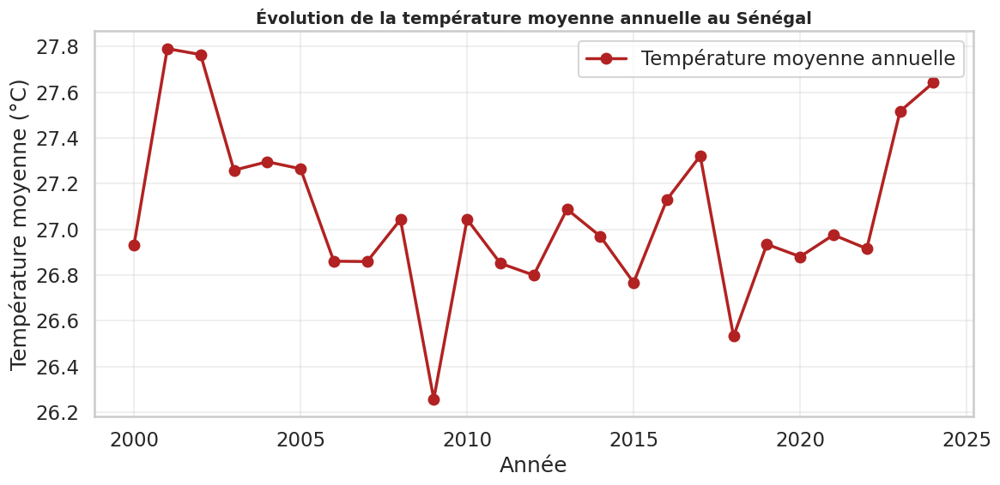

In [0]:
# ======================================================
# ÉVOLUTION DE LA TEMPÉRATURE MOYENNE ANNUELLE — SÉNÉGAL
# ======================================================

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pyspark.sql import functions as F

sns.set_theme(style="whitegrid", context="talk")

# ------------------------------------------------------
# 1) AGRÉGATION ANNUELLE (Spark)
# ------------------------------------------------------
temp_year = (
    df_clean
    .withColumn("year", F.year("date"))
    .groupBy("year")
    .agg(F.avg("temp_mean").alias("temp_mean_nat"))
    .orderBy("year")
)

# Spark -> pandas
pdf_year = temp_year.toPandas()

# ------------------------------------------------------
# 2) GRAPHIQUE — SÉRIE TEMPORELLE
# ------------------------------------------------------
plt.figure(figsize=(12,6))

plt.plot(
    pdf_year["year"],
    pdf_year["temp_mean_nat"],
    marker="o",
    linewidth=2.5,
    color="firebrick",
    label="Température moyenne annuelle"
)

plt.title(
    "Évolution de la température moyenne annuelle au Sénégal",
    fontsize=14,
    weight="bold"
)
plt.xlabel("Année")
plt.ylabel("Température moyenne (°C)")
plt.grid(alpha=0.3)
plt.legend()

plt.tight_layout()
plt.show()

In [0]:
# Histogramme pour UNE variable (temp_mean) à partir de hist_all
hist_temp = hist_all.filter(F.col("variable") == "temp_mean")
display(hist_temp)


variable,bin,bin_start,bin_end,count
temp_mean,0,19.46,19.99266666666667,2479
temp_mean,1,19.99266666666667,20.525333333333332,3334
temp_mean,2,20.525333333333332,21.058,4181
temp_mean,3,21.058,21.590666666666667,5476
temp_mean,4,21.590666666666667,22.123333333333335,6286
temp_mean,5,22.123333333333335,22.656,7457
temp_mean,6,22.656,23.188666666666666,8396
temp_mean,7,23.188666666666666,23.721333333333334,10001
temp_mean,8,23.721333333333334,24.253999999999998,10647
temp_mean,9,24.253999999999998,24.786666666666665,11671


In [0]:
# "Boxplot" compact pour UNE variable (temp_mean) : min, p25, median, p75, max
box_temp = (
    box_ready
    .filter(F.col("variable") == "temp_mean")
    .selectExpr(
        "variable",
        "stack(5, 'min', min, 'p25', p25, 'median', median, 'p75', p75, 'max', max) as (stat, value)"
    )
)

display(box_temp)


variable,stat,value
temp_mean,min,16.3
temp_mean,p25,24.99
temp_mean,median,27.22
temp_mean,p75,28.99
temp_mean,max,39.29


In [0]:


df_clean.write.mode("overwrite").format("delta").saveAsTable("workspace.default.df_clean")




In [0]:
# ======================================================
# SCATTER MAP AVEC INTERPOLATION (Plotly)
# ======================================================

# ------------------------------
# 0) Imports
# ------------------------------
import numpy as np
import pandas as pd
import plotly.express as px
from scipy.interpolate import griddata

# ------------------------------
# 1) Données : Spark -> pandas
# ------------------------------
stations_pdf = (
    df_clean
    .select("latitude", "longitude", "temp_mean")
    .dropna()
    .toPandas()
)

# ------------------------------
# 2) Grille spatiale (Sénégal)
# ------------------------------
lat_min, lat_max = 12.0, 17.0
lon_min, lon_max = -18.5, -11.0

grid_lat = np.linspace(lat_min, lat_max, 60)
grid_lon = np.linspace(lon_min, lon_max, 60)

grid_lat, grid_lon = np.meshgrid(grid_lat, grid_lon)

# ------------------------------
# 3) Interpolation spatiale
# ------------------------------
points = stations_pdf[["latitude", "longitude"]].values
values = stations_pdf["temp_mean"].values

grid_temp = griddata(
    points,
    values,
    (grid_lat, grid_lon),
    method="linear"   # stable
)

# ------------------------------
# 4) Mise en forme scatter interpolé
# ------------------------------
interp_pdf = pd.DataFrame({
    "latitude": grid_lat.flatten(),
    "longitude": grid_lon.flatten(),
    "temp_interp": grid_temp.flatten()
}).dropna()

# ------------------------------
# 5) Scatter map interpolé
# ------------------------------
fig = px.scatter_mapbox(
    interp_pdf,
    lat="latitude",
    lon="longitude",
    color="temp_interp",
    color_continuous_scale="Inferno",
    zoom=5,
    height=600,
    title="Température interpolée – Scatter map"
)

fig.update_layout(
    mapbox_style="carto-positron",
    margin={"r":0, "t":50, "l":0, "b":0}
)

fig

In [0]:
from pyspark.sql import functions as F

from pyspark.sql.window import Window
w = Window.partitionBy("region", "date")

df_meteo = (
    df_clean
    .withColumn("temp_mean_region_daily", F.avg("temp_mean").over(w))
    .withColumn("n_obs_region_day", F.count(F.lit(1)).over(w))  # optionnel: nb obs utilisées
)

display(df_meteo)


date,temp_mean,temp_max,temp_min,dew_point,precip_mm,wind_speed,wind_speed_max,wind_dir,humidity,specific_humidity,surface_pressure,solar_rad_allsky,solar_rad_clearsky,soil_moisture,evapotranspiration,ville,latitude,longitude,region,year,month,month_name,doy,year_month,temp_mean_region_daily,n_obs_region_day
2000-01-01,21.41,21.97,20.84,18.41,0.0,5.6,7.12,352.4,82.98,13.14,100.93,5.2382,5.3321,0.35,0.0432,Dakar,14.6928,-17.4467,Dakar,2000,1,Jan,1,2000-01,21.295,4
2000-01-01,21.41,21.97,20.84,18.41,0.0,5.6,7.12,352.4,82.98,13.14,100.93,5.2382,5.3321,0.35,0.0432,Rufisque,14.7167,-17.2667,Dakar,2000,1,Jan,1,2000-01,21.295,4
2000-01-01,21.18,22.13,20.28,17.98,0.0,5.14,6.41,358.8,81.97,12.79,100.93,5.2382,5.3321,0.35,0.0432,Pikine,14.7547,-17.3983,Dakar,2000,1,Jan,1,2000-01,21.295,4
2000-01-01,21.18,22.13,20.28,17.98,0.0,5.14,6.41,358.8,81.97,12.79,100.93,5.2382,5.3321,0.35,0.0432,Guédiawaye,14.7692,-17.4097,Dakar,2000,1,Jan,1,2000-01,21.295,4
2000-01-02,22.49,25.07,20.08,15.94,0.0,4.57,6.31,46.3,67.46,11.3,100.9,4.68,4.7827,0.35,0.0298,Dakar,14.6928,-17.4467,Dakar,2000,1,Jan,2,2000-01,22.41,4
2000-01-02,22.49,25.07,20.08,15.94,0.0,4.57,6.31,46.3,67.46,11.3,100.9,4.68,4.7827,0.35,0.0298,Rufisque,14.7167,-17.2667,Dakar,2000,1,Jan,2,2000-01,22.41,4
2000-01-02,22.33,25.25,20.06,15.53,0.01,6.01,8.15,51.4,66.89,11.04,100.91,4.68,4.7827,0.35,0.0298,Pikine,14.7547,-17.3983,Dakar,2000,1,Jan,2,2000-01,22.41,4
2000-01-02,22.33,25.25,20.06,15.53,0.01,6.01,8.15,51.4,66.89,11.04,100.91,4.68,4.7827,0.35,0.0298,Guédiawaye,14.7692,-17.4097,Dakar,2000,1,Jan,2,2000-01,22.41,4
2000-01-03,22.08,23.4,20.53,15.76,0.07,5.32,7.56,48.3,67.57,11.11,100.94,4.6164,4.848,0.35,0.0514,Dakar,14.6928,-17.4467,Dakar,2000,1,Jan,3,2000-01,21.9,4
2000-01-03,22.08,23.4,20.53,15.76,0.07,5.32,7.56,48.3,67.57,11.11,100.94,4.6164,4.848,0.35,0.0514,Rufisque,14.7167,-17.2667,Dakar,2000,1,Jan,3,2000-01,21.9,4


root
 |-- date: date (nullable = true)
 |-- temp_mean: double (nullable = true)
 |-- temp_max: double (nullable = true)
 |-- temp_min: double (nullable = true)
 |-- dew_point: double (nullable = true)
 |-- precip_mm: double (nullable = true)
 |-- wind_speed: double (nullable = true)
 |-- wind_speed_max: double (nullable = true)
 |-- wind_dir: double (nullable = true)
 |-- humidity: double (nullable = true)
 |-- specific_humidity: double (nullable = true)
 |-- surface_pressure: double (nullable = true)
 |-- solar_rad_allsky: double (nullable = true)
 |-- solar_rad_clearsky: double (nullable = true)
 |-- soil_moisture: double (nullable = true)
 |-- evapotranspiration: double (nullable = true)
 |-- ville: string (nullable = true)
 |-- latitude: double (nullable = true)
 |-- longitude: double (nullable = true)
 |-- region: string (nullable = true)
 |-- year: integer (nullable = true)
 |-- month: integer (nullable = true)
 |-- month_name: string (nullable = true)
 |-- doy: integer (nullable

In [0]:
from pyspark.sql import functions as F

# 1) sélectionner les variables (adapte le nom de la pluviométrie si besoin)
# Exemples possibles: "pluie", "precip", "prcp", "precipitation"
df_filter = (
    df_meteo
    .select(
        "region",
        "date",
        "precip_mm",              # <-- remplace par le vrai nom de ta colonne pluie
        "temp_mean_region_daily",
        "temp_mean"
    )
)

# 2) date -> date, puis année
df = df_meteo.withColumn("date", F.to_date(F.col("date")))
df = df_meteo.withColumn("year", F.year(F.col("date")))

# 3) nb jours chauds/an sans filtrer: on somme un indicateur (1 si >32 sinon 0)
jours_chauds_par_an = (
    df.groupBy("region", "year")
      .agg(
          F.sum(F.when(F.col("temp_mean_region_daily") > 32, 1).otherwise(0)).cast("int")
          .alias("nb_jours_chauds")
      )
      .orderBy("region", "year")
)

df_filter.show(truncate=False)


+------+----------+---------+----------------------+---------+
|region|date      |precip_mm|temp_mean_region_daily|temp_mean|
+------+----------+---------+----------------------+---------+
|Dakar |2000-01-01|0.0      |21.295                |21.41    |
|Dakar |2000-01-01|0.0      |21.295                |21.41    |
|Dakar |2000-01-01|0.0      |21.295                |21.18    |
|Dakar |2000-01-01|0.0      |21.295                |21.18    |
|Dakar |2000-01-02|0.0      |22.41                 |22.49    |
|Dakar |2000-01-02|0.0      |22.41                 |22.49    |
|Dakar |2000-01-02|0.01     |22.41                 |22.33    |
|Dakar |2000-01-02|0.01     |22.41                 |22.33    |
|Dakar |2000-01-03|0.07     |21.9                  |22.08    |
|Dakar |2000-01-03|0.07     |21.9                  |22.08    |
|Dakar |2000-01-03|0.11     |21.9                  |21.72    |
|Dakar |2000-01-03|0.11     |21.9                  |21.72    |
|Dakar |2000-01-04|4.94     |22.654999999999998    |22.

In [0]:

display(df_filter)

region,date,precip_mm,temp_mean_region_daily,temp_mean
Dakar,2000-01-01,0.0,21.295,21.41
Dakar,2000-01-01,0.0,21.295,21.41
Dakar,2000-01-01,0.0,21.295,21.18
Dakar,2000-01-01,0.0,21.295,21.18
Dakar,2000-01-02,0.0,22.41,22.49
Dakar,2000-01-02,0.0,22.41,22.49
Dakar,2000-01-02,0.01,22.41,22.33
Dakar,2000-01-02,0.01,22.41,22.33
Dakar,2000-01-03,0.07,21.9,22.08
Dakar,2000-01-03,0.07,21.9,22.08


In [0]:
# Chemin S3 de sortie (bucket + dossier du projet)
output_path = "s3://ensae-student-data-mbb/data-meteo-eco-projet/data_final_meteo"
(
    df_filter     
      .write            
      .mode("overwrite") # remplace les données existantes
      .parquet(output_path)  # écrit en Parquet dans S3
)
print("Parquet écrit dans :", output_path)

Parquet écrit dans : s3://ensae-student-data-mbb/data-meteo-eco-projet/data_final_meteo


In [0]:
from pyspark.sql import functions as F

T_BASE = 8
T_CAP  = 32

temp_daily_region = (
    df_filter
    # (optionnel) garder les seuils dans la table
    .withColumn("T_BASE", F.lit(T_BASE))
    .withColumn("T_CAP",  F.lit(T_CAP))
    # création de la variable GDD sans filtrer
    .withColumn(
        "GDD",
        F.greatest(
            F.lit(0.0),
            (F.least(F.col("temp_mean_region_daily"), F.lit(T_CAP)) - F.lit(T_BASE)).cast("double")
        )
    )
)



In [0]:
display(temp_daily_region)

In [0]:
display(df_culture)

In [0]:
display(df_precip)

In [0]:
from pyspark.sql.functions import month, dayofmonth

df_croissance = (
    df_precip
    .filter(
        (
            (month("date") > 6) | (month("date") == 6)   # juin à décembre
        ) &
        (
            (month("date") < 10) | ((month("date") == 10) & (dayofmonth("date") <= 30))  # jusqu'au 30 oct
        )
    )
)



In [0]:
display(df_croissance)

In [0]:


# --- ÉTAPE 1: PRÉPARATION DES VARIABLES NÉCESSAIRES ---

# 1.1 Créer la colonne 'annee' (si elle n'existe pas déjà)
df_temp = df_croissance.withColumn(
    "annee",
    F.year(F.col("date")) 
    # Assurez-vous que la colonne "date" est bien de type Date/Timestamp ou ajustez F.to_date() si nécessaire.
)

# 1.2 Créer la colonne binaire pour les Jours Chauds
# Un jour est chaud si temp_mean > 32. On utilise F.when() et F.lit() pour créer un 0 ou un 1.
df_temp = df_temp.withColumn(
    "is_hot_day",
    F.when(F.col("temp_mean") > 32, F.lit(1)).otherwise(F.lit(0))
)

# --- ÉTAPE 2: DÉFINITION DE LA FENÊTRE ET CALCULS ---

# 2.1 Définition de la Fenêtre
# On partitionne par 'annee' et 'region'. C'est le groupe sur lequel les sommes seront calculées.
window_spec = Window.partitionBy("annee", "region").rowsBetween(
    Window.unboundedPreceding, 
    Window.unboundedFollowing
)

# 2.2 Calcul du Nombre de Jours Chauds
# On fait la somme de la colonne binaire 'is_hot_day' sur toute la fenêtre. 
# La somme des 1 (jours chauds) est égale au nombre total de jours chauds.
df_resultat = df_temp.withColumn(
    "nombre_jours_chauds_annuel",
    F.sum("is_hot_day").over(window_spec)
)

# 2.3 Calcul de la Chaleur Utile (Somme de GDD)
# On fait la somme de la colonne 'GDD' sur toute la même fenêtre.
df_resultat = df_resultat.withColumn(
    "chaleur_utile_annuelle",
    F.sum("GDD").over(window_spec)
)

# --- ÉTAPE 3: VÉRIFICATION ---

# Affiche les colonnes pertinentes pour vérifier les nouvelles valeurs
df_resultat.select(
    "date",
    "annee",
    "region",
    "temp_mean",
    "GDD",
    "is_hot_day",
    "nombre_jours_chauds_annuel",
    "chaleur_utile_annuelle"
).show(5, truncate=False)

# Vérification du nombre de lignes (doit être égal au nombre de lignes initiales)
# print(df_resultat.count())

In [0]:
display(df_resultat)

In [0]:
# 1. Sélectionner les colonnes pertinentes
# On garde les clés (annee, region) et les variables agrégées que vous venez de créer.
df_agregation_finale = df_resultat.select(
    "annee",
    "region",
    "somme_precip_annuelle_regionale",
    "nombre_jours_chauds_annuel",
    "chaleur_utile_annuelle"
)
# 2. Utiliser la fonction DISTINCT
# Puisque les valeurs agrégées sont identiques pour chaque ligne d'une même paire (année, région),
# l'opération distinct() ne conservera qu'une seule ligne pour chaque combinaison unique.
df_base_meteo = df_agregation_finale.distinct()

# 3. Affichage du résultat
print("Nombre de lignes de la nouvelle base (années x régions) :", df_base_annee_region.count())
df_base_meteo.orderBy("annee", "region").show(10, truncate=False)

In [0]:

# Définir les bornes pour le filtrage
annee_min = 2010
annee_max = 2022

# Filtrer le DataFrame pour ne garder que les années entre 2010 et 2022 incluses
df_base_meteo = df_base_meteo.filter(
    (F.col("annee") >= annee_min) & (F.col("annee") <= annee_max)
)

# Affichage des 10 premières lignes du résultat pour vérification
print(f"Nombre de lignes dans la base filtrée (années {annee_min} à {annee_max}) :", df_base_meteo.count())
df_base_meteo.orderBy("annee").show(10)
display(df_base_meteo)

In [0]:
df_base_meteo = df_base_meteo.withColumn(
    "region",
    F.when(F.col("region") == "Thiès", "Thies")
     .when(F.col("region") == "Sédhiou", "Sedhiou")
     .when(F.col("region") == "Kédougou", "Kedougou")
     .otherwise(F.col("region"))
)

In [0]:
# 1. Charger la table enregistrée dans le catalogue "default"
df_culture = spark.table("bases_projet.base_agricole")  

# 2. Vérifier la structure
df_culture.printSchema()



In [0]:


def count_missing_values(df):
    """
    Calcule et affiche le nombre de valeurs nulles (manquantes)
    pour chaque colonne d'un DataFrame Spark.
    """
    # Liste pour stocker les expressions d'agrégation (une par colonne)
    agg_expressions = []
    
    # Parcourir toutes les colonnes du DataFrame
    for col_name in df.columns:
        # F.count(F.when(condition, 1)) compte le nombre de lignes où la condition est vraie.
        # F.isnull(col_name) vérifie si la valeur est NULL.
        agg_expr = F.sum(F.when(F.col(col_name).isNull(), 1).otherwise(0)).alias(col_name)
        agg_expressions.append(agg_expr)
        
    # Appliquer toutes les agrégations sur l'ensemble du DataFrame
    # Le résultat est un DataFrame avec une seule ligne
    missing_counts_df = df.agg(*agg_expressions)
    
    # Transformer le résultat en un format facile à lire (Pandas ou affichage ligne par ligne)
    
    # Méthode 1: Afficher le DataFrame Spark (une seule ligne)
    print("--- Nombre de Valeurs Manquantes (NULLS) ---")
    missing_counts_df.show(truncate=False)

    # Méthode 2: Collecter et afficher comme une liste clé/valeur pour plus de clarté
    # C'est utile si le DataFrame a beaucoup de colonnes.
    print("\n--- Récapitulatif par Colonne ---")
    results = missing_counts_df.collect()[0].asDict()
    
    for col, count in results.items():
        if count > 0:
            print(f"La colonne '{col}' a {count} valeurs manquantes.")
        else:
            print(f"La colonne '{col}' n'a PAS de valeurs manquantes.")

# Exécution pour votre DataFrame
count_missing_values(df_culture)

In [0]:
# Filtrer le DataFrame pour ne conserver que les lignes où 'yield' est strictement égal à 0
df_culture_zero = df_culture.filter(F.col("yield") == 0)

# Affichage du nombre de lignes trouvées
nombre_lignes_zero = df_culture_zero.count()
print(f"Nombre de lignes où le rendement ('yield') est égal à 0 : {nombre_lignes_zero}")

# Affichage des premières lignes pour inspection
print("\n--- Exemples de lignes avec rendement nul ---")
df_culture_zero.show(20, truncate=False)

# On va imputer par la médiane les valeurs égales à zéro dans la variable **Yield**

In [0]:

# PRÉPARATION (Calcul de la Médiane des Rendements NON NULS) ---

# 1. Définition de la fenêtre de regroupement (par region et culture)
window_spec = Window.partitionBy("region", "culture")

# 2. Création d'une colonne temporaire où les '0' sont transformés en NULL
# Crucial pour que les zéros ne soient pas inclus dans le calcul de la médiane.
df_temp = df_culture.withColumn(
    "yield_non_zero",
    F.when(F.col("yield") > 0, F.col("yield")).otherwise(F.lit(None))
)

# 3. Calcul de la médiane (50e percentile)
# F.percentile_approx() est la fonction recommandée dans Spark pour la médiane (0.5).
# Le dernier argument (e.g., 1000) contrôle la précision vs. performance.
df_temp = df_temp.withColumn(
    "median_imputation_value",
    F.percentile_approx(F.col("yield_non_zero"), F.lit(0.5), F.lit(1000)).over(window_spec)
)

# --- ÉTAPE 2: APPLICATION DE L'IMPUTATION ---

# 4. Création de la colonne 'yield_imputed_median'
# Si 'yield' était 0, on le remplace par 'median_imputation_value'. Sinon, on garde la valeur d'origine.
df_impute_median = df_temp.withColumn(
    "yield_imputed_median",
    F.when(F.col("yield") == 0, F.col("median_imputation_value")).otherwise(F.col("yield"))
)

# --- ÉTAPE 3: GESTION DES NOUVEAUX NULLS (Imputation Échouée) ---

# Comme nous l'avons vu, certains groupes (region, culture) peuvent n'avoir que des 0, 
# ce qui entraîne une 'median_imputation_value' de NULL.
# Nous allons utiliser la médiane nationale de la culture pour imputer ces cas.

# 5. Calcul de la Médiane Nationale pour chaque Culture
window_national_culture = Window.partitionBy("culture")

df_impute_median = df_impute_median.withColumn(
    "national_median_culture",
    F.percentile_approx(F.col("yield_non_zero"), F.lit(0.5), F.lit(1000)).over(window_national_culture)
)

# 6. Imputation Finale (Si yield_imputed_median est NULL, utiliser la médiane nationale)
df_finale_culture = df_impute_median.withColumn(
    "yield_imputed_final",
    F.when(F.col("yield_imputed_median").isNull(), F.col("national_median_culture"))
     .otherwise(F.col("yield_imputed_median"))
)

#  VÉRIFICATION ---
print("--- Vérification de l'imputation par médiane ---")
df_finale_culture.filter(F.col("yield") == 0).select(
    "region",
    "culture",
    F.col("yield").alias("yield_original"),
    "yield_imputed_final"
).show(20, truncate=False)

### On remarque les valeurs de rendements culturels nuls ont été corrigé.


In [0]:

#  PRÉPARATION (Calcul de la Médiane des Rendements NON NULS) ---

# 1. Définition de la fenêtre de regroupement (par region et culture)
window_spec = Window.partitionBy("region", "culture")

# 2. Création d'une colonne temporaire où les '0' sont transformés en NULL
# Crucial pour que les zéros ne soient pas inclus dans le calcul de la médiane.
df_temp = df_culture.withColumn(
    "yield_non_zero",
    F.when(F.col("yield") > 0, F.col("yield")).otherwise(F.lit(None))
)

# 3. Calcul de la médiane (50e percentile)
# F.percentile_approx() est la fonction recommandée dans Spark pour la médiane (0.5).
# Le dernier argument (e.g., 1000) contrôle la précision vs. performance.
df_temp = df_temp.withColumn(
    "median_imputation_value",
    F.percentile_approx(F.col("yield_non_zero"), F.lit(0.5), F.lit(1000)).over(window_spec)
)

# --- ÉTAPE 2: APPLICATION DE L'IMPUTATION ---

# 4. Création de la colonne 'yield_imputed_median'
# Si 'yield' était 0, on le remplace par 'median_imputation_value'. Sinon, on garde la valeur d'origine.
df_impute_median = df_temp.withColumn(
    "yield_imputed_median",
    F.when(F.col("yield") == 0, F.col("median_imputation_value")).otherwise(F.col("yield"))
)

# --- ÉTAPE 3: GESTION DES NOUVEAUX NULLS (Imputation Échouée) ---

# Comme nous l'avons vu, certains groupes (region, culture) peuvent n'avoir que des 0, 
# ce qui entraîne une 'median_imputation_value' de NULL.
# Nous allons utiliser la médiane nationale de la culture pour imputer ces cas.

# 5. Calcul de la Médiane Nationale pour chaque Culture
window_national_culture = Window.partitionBy("culture")

df_impute_median = df_impute_median.withColumn(
    "national_median_culture",
    F.percentile_approx(F.col("yield_non_zero"), F.lit(0.5), F.lit(1000)).over(window_national_culture)
)

# 6. Imputation Finale (Si yield_imputed_median est NULL, utiliser la médiane nationale)
df_finale_culture = df_impute_median.withColumn(
    "yield_imputed_final",
    F.when(F.col("yield_imputed_median").isNull(), F.col("national_median_culture"))
     .otherwise(F.col("yield_imputed_median"))
)

df_culture = df_finale_culture

In [0]:
df_culture = df_finale_culture
display(df_culture)


In [0]:
display(df_meteo_final)

In [0]:
# S'assurer que les noms de colonnes sont cohérents. 
# La base de rendements (image) utilise 'year' et 'region'.
# La base climatique utilise 'annee' et 'region'.

# Si nécessaire, renommer la colonne 'year' en 'annee' dans la base de rendement pour une jointure facile.
df_agricole_meteo = df_culture.withColumnRenamed("year", "annee") 

# Clés de jointure
join_keys = ["annee", "region"]

# Jointure des deux DataFrames
# Le type 'inner' ne conservera que les lignes qui existent dans les deux bases (année et région).
df_culture_meteo = df_base_meteo.join(
    df_agricole_meteo,
    on=join_keys,
    how="inner" # Ou 'left' si vous voulez garder toutes les lignes climatiques, même sans rendement.
)
display(df_culture_meteo)

In [0]:
# Liste des colonnes intermédiaires à supprimer (incluant la correction des noms)
colonnes_a_supprimer = [
    "yield",
    "yield_non_zero",
    "median_imputation_value",   # Doublon dans votre liste 
    "national_median_culture",
    "yield_imputed_median",
    "national_median_culture"
]

# Suppression en une seule ligne (si le DataFrame existe)
df_culture_meteo = df_culture_meteo.drop(*colonnes_a_supprimer)


# --- Vérification du résultat ---

print("--- Schéma du DataFrame Final Propre (Méthode .drop() simplifiée) ---")
df_culture_meteo.printSchema()

In [0]:
df_culture_meteo.count()

In [0]:
display(df_culture_meteo)